 # <center> Checkerboard 2 Colors Data Analysis </center>

In [1]:
%load_ext autoreload
%autoreload 2

import os
import params
from utils import *
import numpy as np
import matplotlib.pyplot as plt
import math
from scipy.optimize import curve_fit
from scipy.ndimage import convolve
from matplotlib.gridspec import GridSpec
from PIL import Image

### Cell 1: Load data

Loading all data. mendatory for each run !

In [5]:
"""
    Variables
    
    DO NOT CHANGE VALUES HERE UNLESS DEBUG/SPECIFIC USE
    
    All the variables used in this part of the cell should always refere to your 'params.py' file
    unless you want to manually change them only for this run (i.e. debugging). 
    You may have to add those variable into the function you want to adapt as only the minimal 
    amount of var are currently given to functions as inputs.
"""

#Link to the actual raw files from the recording listed in the input_file
recording_directory     = params.recording_directory

# Directory where preprocessing info are saved
output_directory        = params.output_directory

#folder in which the triggers are saved
triggers_directory      = params.triggers_directory

#name of your experiment for saving the triggers
exp                     = params.exp

#Number of frames in each checkerboard sequence
nb_frames_by_sequence = params.nb_frames_by_sequence
nb_repeated = int(nb_frames_by_sequence/2)
nb_non_repeated = nb_repeated

#Recordings labels available
recording_names = params.recording_names

#Sampling frequency of the MEA
fs = params.fs



"""
    Inputs
"""

#Getting right recording name
print('Which of the following is the checkerboard : ')
for num, rec in enumerate(recording_names):
    print(f'\t{num} --> {rec}')
recording_number = int(input('Checkerboard number : '))
checkerboard_name = recording_names[recording_number]
print('Selected recording: {}\n'.format(checkerboard_name))

#Frequency at which your stim has been played
stimulus_frequency = int(input("Select stimulus Frequency (usually 30Hz) : ")) # Change the frequency

#Nb of checks used on the checkerboard
nb_checks_x = int(input("Select number of checks on x (usually 40 for fine checkerboard) : "))   ##### Here change the number of checks if necessary
nb_checks_y = int(input("Select number of checks on y (usually 40 for fine checkerboard) : "))   ##### Here change the number of checks if necessary

check_directory = os.path.normpath(os.path.join(output_directory,r'Checkerboard_Analysis_rec_{}'.format(recording_number)))
if not os.path.isdir(check_directory): os.makedirs(check_directory)

color1='violet'
color2='orange'


"""
    Processing
"""

#Checkerboard file where triggers were recorded
triggers_file = os.path.normpath(os.path.join(triggers_directory,r"{}_{}_triggers.pkl".format(exp,checkerboard_name)))
triggers_data = load_obj(triggers_file)

#File where the spikes of all the recordings of the experiment are saved
neurons_file  = os.path.normpath(os.path.join(output_directory,r'{}_fullexp_neurons_data.pkl'.format(exp)))
all_recs_spikes = load_obj(neurons_file)


#keep only the spikes recorded during checkerboard
checkerboard_spikes = get_recording_spikes(checkerboard_name, all_recs_spikes)
cells_id = list(checkerboard_spikes.keys())
triggers = triggers_data['indices']/fs
nb_repeats = int((len(triggers)-nb_repeated)/nb_frames_by_sequence)
duration_sequence = int(nb_frames_by_sequence/stimulus_frequency)

#Used to separate the triggers between the two colors
triggers_c1 = np.concatenate([ triggers[i:i+nb_frames_by_sequence] for i in range(nb_non_repeated, len(triggers), 2*nb_frames_by_sequence) ])
triggers_c2 = np.concatenate([ triggers[i:i+nb_frames_by_sequence] for i in range(nb_non_repeated+nb_frames_by_sequence, len(triggers), 2*nb_frames_by_sequence) ])
triggers_c1=triggers_c1[0:int(len(triggers_c1)/nb_frames_by_sequence)*nb_frames_by_sequence]
triggers_c2=triggers_c2[0:int(len(triggers_c2)/nb_frames_by_sequence)*nb_frames_by_sequence]

nb_repeats_c1 = int(len(triggers_c1)/nb_frames_by_sequence)
nb_repeats_c2 = int(len(triggers_c2)/nb_frames_by_sequence)


print("\nCheckerboard Stats :\n\t- {} min total duration \n\t- {} triggers \n\t- {} complete sequences\n\t- {} seconds per sequence\n".format(
      int(triggers_data['duration']/fs/60),len(triggers),
      nb_repeats, duration_sequence))


nb_frames = int(nb_repeats_c1*nb_non_repeated+nb_repeats_c2*nb_non_repeated+nb_non_repeated)
stimulus_path = os.path.normpath(os.path.join(check_directory, "checkerboard_{}x{}checks_{}frames.npy".format(nb_checks_x,nb_checks_y,nb_frames)))

if os.path.isfile(stimulus_path):
    print("Stimulus file exists. Loaded from :\t {}".format(stimulus_path))
    checkerboard = np.load(stimulus_path)
else:
    print("Reconstructing the stimulus...")
    checkerboard = checkerboard_from_binary(nb_frames, nb_checks_x, nb_checks_y, checkerboard_file = stimulus_path, binary_source_path=params.binary_source_path)

#Separate the checkerboard for the two colors
checkerboard_c1=np.zeros([nb_repeats_c1*nb_non_repeated,40,40])
checkerboard_c2=np.zeros([nb_repeats_c2*nb_non_repeated+nb_non_repeated,40,40])

for seq in range(nb_repeats_c1+nb_repeats_c2):
    if seq/2==int(seq/2):
        checkerboard_c2[int(seq/2)*nb_non_repeated:(int(seq/2)+1)*nb_non_repeated]=checkerboard[seq*nb_non_repeated:(seq+1)*nb_non_repeated]
    else:
        checkerboard_c1[(int(seq/2))*nb_non_repeated:(int(seq/2)+1)*nb_non_repeated]=checkerboard[seq*nb_non_repeated:(seq+1)*nb_non_repeated]

checkerboard_c2=checkerboard_c2[nb_non_repeated:]

print('Total : {} neurons loaded \n\nClusters id :\n{}\n'.format(len(checkerboard_spikes.keys()),cells_id))


Which of the following is the checkerboard : 
	0 --> 20240905-meas00-check-30Hz-15px40ch-530nm_1e4-bis
	1 --> 20240905-meas01-2col_check-30Hz-15px40ch-385nm_5e2-530_1e4
	2 --> 20240905-meas02-2col_check-30Hz-15px40ch-385nm_1e4-530_1e4
	3 --> 20240905-meas03-check-30Hz-15px40ch-530nm_1e4
	4 --> 20240905-meas04-check-30Hz-15px40ch-530nm_1e5
	5 --> 20240905-meas05-check-30Hz-15px40ch-530nm_1e6
	6 --> 20240905-meas06-check-30Hz-15px40ch-530nm_1e4


Checkerboard number :  2


Selected recording: 20240905-meas02-2col_check-30Hz-15px40ch-385nm_1e4-530_1e4



Select stimulus Frequency (usually 30Hz) :  30
Select number of checks on x (usually 40 for fine checkerboard) :  40
Select number of checks on y (usually 40 for fine checkerboard) :  40



Checkerboard Stats :
	- 62 min total duration 
	- 110828 triggers 
	- 91 complete sequences
	- 40 seconds per sequence

Stimulus file exists. Loaded from :	 /home/quetutom/Desktop/20240905/Analysis/Checkerboard_Analysis_rec_2/checkerboard_40x40checks_55200frames.npy
Total : 109 neurons loaded 

Clusters id :
[10, 13, 16, 22, 31, 32, 34, 41, 44, 48, 50, 53, 67, 83, 85, 92, 93, 94, 96, 99, 103, 107, 108, 127, 130, 134, 145, 149, 151, 153, 156, 159, 160, 167, 169, 172, 173, 176, 187, 188, 192, 197, 199, 217, 219, 228, 229, 233, 237, 238, 239, 255, 256, 259, 261, 264, 271, 272, 279, 289, 291, 302, 320, 321, 322, 325, 329, 353, 355, 356, 359, 361, 380, 387, 410, 418, 438, 439, 452, 458, 460, 461, 467, 479, 480, 492, 504, 514, 522, 531, 548, 552, 553, 558, 565, 575, 576, 602, 603, 607, 612, 619, 632, 636, 640, 650, 651, 660, 665]



### Cell 2 : Plot Raster plots and PSTH

Analysis on repeated sequence

#### <center><i>REQUIRES CELL 1 RUN</center>

Building rasters...


  0%|          | 0/109 [00:00<?, ?it/s]

Ploting...


  0%|          | 0/121 [00:00<?, ?it/s]

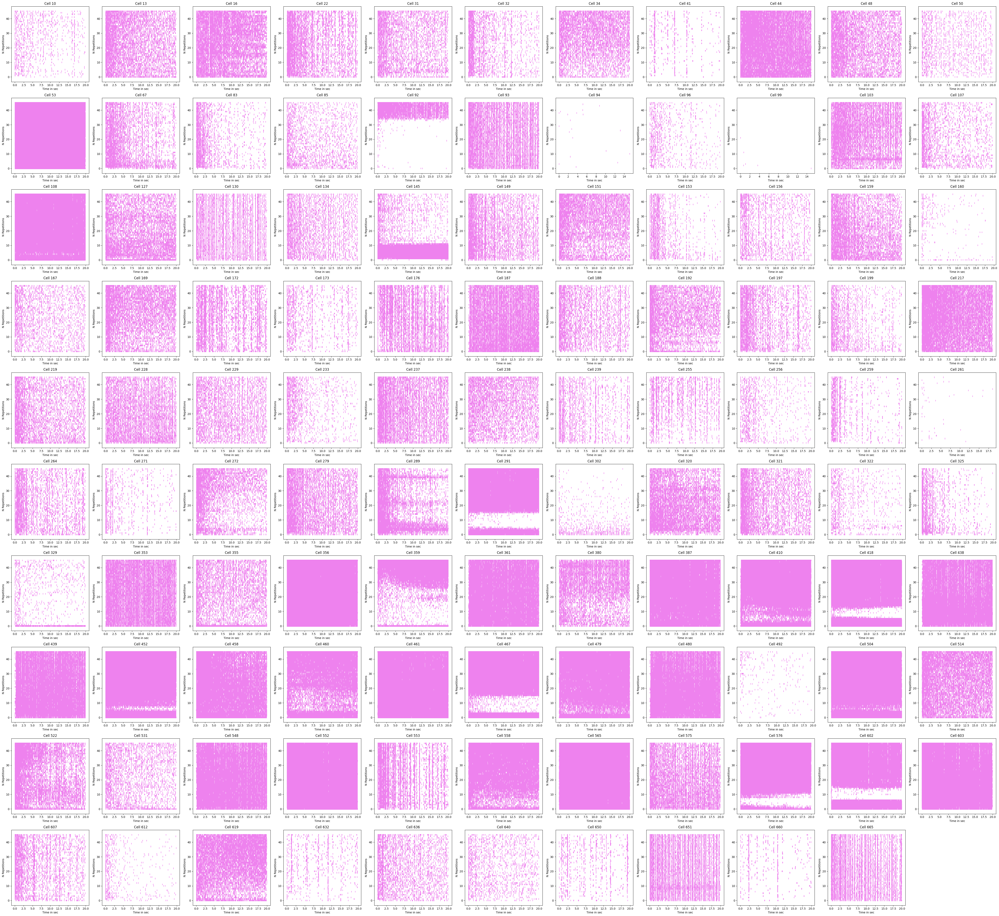

Ploting...


  0%|          | 0/121 [00:00<?, ?it/s]

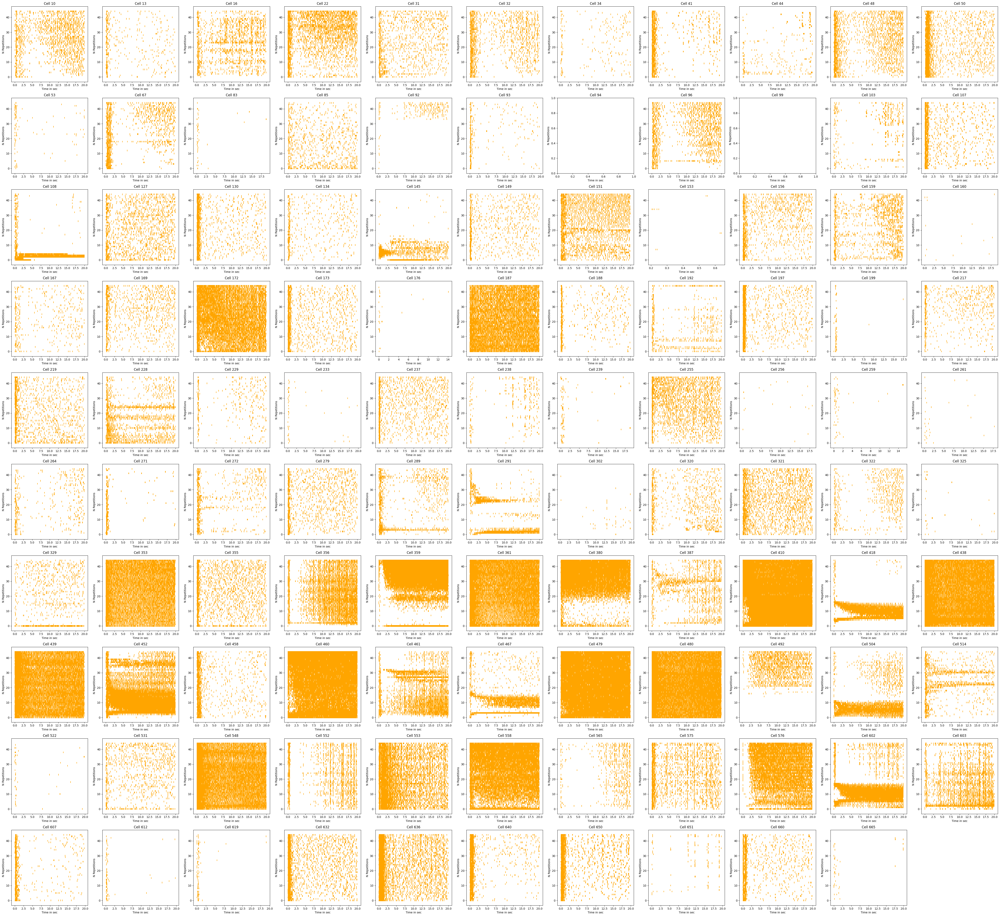

--- Cell Done ---


In [6]:
"""
    Variables
    
    DO NOT CHANGE VALUES HERE UNLESS DEBUG/SPECIFIC USE
    
    All the variables used in this part of the cell should always refere to your 'params.py' file
    unless you want to manually change them only for this run (i.e. debugging). 
    You may have to add those variable into the function you want to adapt as only the minimal 
    amount of var are currently given to functions as inputs.
"""

# Length of each sequence composed of half repeated sequence and half random sequence
nb_frames_by_sequence = params.nb_frames_by_sequence



"""
    Input
"""
save_fig = False

ploting = True



"""
    Processing
"""

raster_data = {}
print('Building rasters...')
for (cell_id, spike_times) in tqdm(checkerboard_spikes.items()):

    # Get rasters on repeated sequence
    raster_data_c1 = extract_from_sequence(spike_times, triggers_c1, nb_repeats_c1, stim_frequency = stimulus_frequency, sequence_portion=(0,0.5))
    raster_data_c2 = extract_from_sequence(spike_times, triggers_c2, nb_repeats_c2, stim_frequency = stimulus_frequency, sequence_portion=(0,0.5))
    raster_data[cell_id] = [raster_data_c1,raster_data_c2]


# Plot all the rasters. Takes a few seconds.
if ploting :
    size = int(math.sqrt(len(cells_id)))+1

    fig, axs = plt.subplots(nrows = size, ncols=size, figsize = (50,50))
    print('Ploting...')
    for i in tqdm(range(size**2)):
        ax = axs[i//size,i%size]
        if i < len(cells_id):
            ax.eventplot(raster_data[cells_id[i]][0]["spike_trains"],color=color1)
            ax.set(title = "Cell {}".format(cells_id[i]),xlabel='Time in sec', ylabel='N Repetitions')
        else : ax.set_visible(False)


    plt.tight_layout()
    plt.show(block=False)
    plt.close('all')
    
    fig, axs = plt.subplots(nrows = size, ncols=size, figsize = (50,50))
    print('Ploting...')
    for i in tqdm(range(size**2)):
        ax = axs[i//size,i%size]
        if i < len(cells_id):
            ax.eventplot(raster_data[cells_id[i]][1]["spike_trains"],color=color2)
            ax.set(title = "Cell {}".format(cells_id[i]),xlabel='Time in sec', ylabel='N Repetitions')
        else : ax.set_visible(False)


    plt.tight_layout()
    plt.show(block=False)
    plt.close('all')


# Saving options creating a folder with all rasters, one file per cell.
if save_fig:
    print("Saving rasters ...")
    fig_directory = os.path.normpath(os.path.join(check_directory,r'Rasters_figs'.format(recording_number)))
    if not os.path.isdir(fig_directory): os.makedirs(fig_directory)
    
    for cell_nb in tqdm(cells_id):
        fig, axs = plt.subplots(nrows = 2,ncols = 2, sharex=True, gridspec_kw={'height_ratios': [3, 1]}, figsize=(20,10))

        plt.suptitle(f'Cell {cell_nb}')
        
        ax_rast = axs[0,0]
        ax_rast.eventplot(raster_data[cell_nb][0]["spike_trains"],color=color1)
        ax_rast.set(title = "Raster plot", ylabel='N Repetitions')

        ax_psth = axs[1,0]
        width = (raster_data[cell_nb][0]["repeated_sequences_times"][0][0]/int(nb_frames_by_sequence/2))
        seq_lenght=raster_data[cell_nb][0]["repeated_sequences_times"][0][1]-raster_data[cell_nb][0]["repeated_sequences_times"][0][0]
        ax_psth.bar(np.linspace(0,seq_lenght,int(nb_frames_by_sequence/2))+width/2, raster_data[cell_nb][0]["psth"], width=1.3*width,color=color1)
        ax_psth.set(xlabel='Time in sec', ylabel='Firing rate (spikes/s)')

        plt.subplots_adjust(wspace=0, hspace=0)

        ax_rast = axs[0,1]
        ax_rast.eventplot(raster_data[cell_nb][1]["spike_trains"],color=color2)
        ax_rast.set(title = "Raster plot", ylabel='N Repetitions')

        ax_psth = axs[1,1]
        width = (raster_data[cell_nb][1]["repeated_sequences_times"][0][0]/int(nb_frames_by_sequence/2))
        seq_lenght=raster_data[cell_nb][1]["repeated_sequences_times"][0][1]-raster_data[cell_nb][1]["repeated_sequences_times"][0][0]
        ax_psth.bar(np.linspace(0,seq_lenght,int(nb_frames_by_sequence/2))+width/2, raster_data[cell_nb][1]["psth"], width=1.3*width,color=color2)
        ax_psth.set(xlabel='Time in sec', ylabel='Firing rate (spikes/s)')

        plt.subplots_adjust(wspace=0.2, hspace=0)

        
        fig_file = os.path.join(fig_directory,f'Cell_{cell_nb}.png')
        plt.savefig(fig_file, dpi=fig.dpi)
        plt.clf()
        plt.close()


raster_dir=os.path.join(check_directory,'Check_rasters_data.pkl')
save_obj(raster_data,raster_dir)


print('--- Cell Done ---')


### Cell 4 : Sanity check one cell at a time

Total : 109 neurons found 

Clusters id :
[10, 13, 16, 22, 31, 32, 34, 41, 44, 48, 50, 53, 67, 83, 85, 92, 93, 94, 96, 99, 103, 107, 108, 127, 130, 134, 145, 149, 151, 153, 156, 159, 160, 167, 169, 172, 173, 176, 187, 188, 192, 197, 199, 217, 219, 228, 229, 233, 237, 238, 239, 255, 256, 259, 261, 264, 271, 272, 279, 289, 291, 302, 320, 321, 322, 325, 329, 353, 355, 356, 359, 361, 380, 387, 410, 418, 438, 439, 452, 458, 460, 461, 467, 479, 480, 492, 504, 514, 522, 531, 548, 552, 553, 558, 565, 575, 576, 602, 603, 607, 612, 619, 632, 636, 640, 650, 651, 660, 665]



Wich cell to select :  10


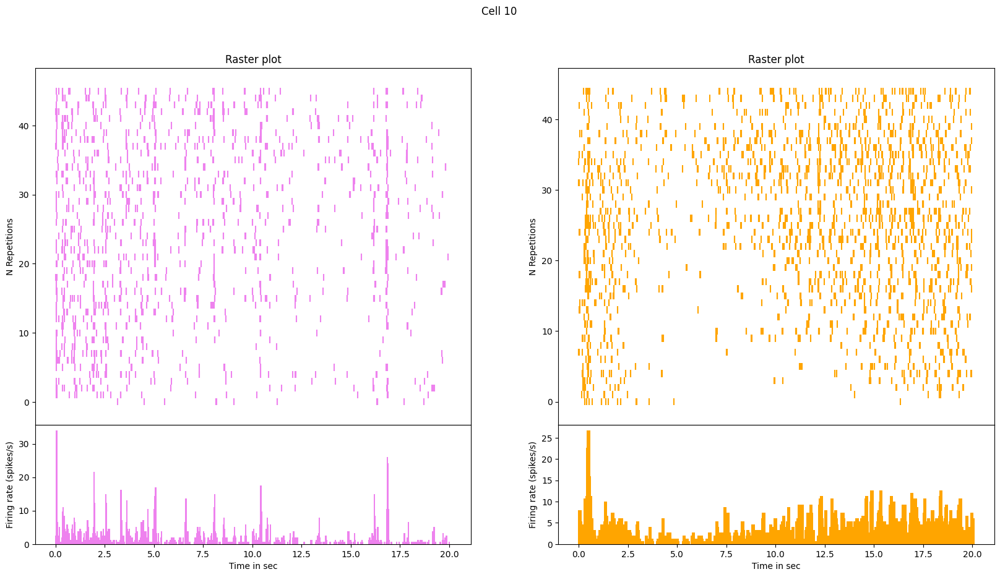

In [11]:
"""
    Input
"""
print('Total : {} neurons found \n\nClusters id :\n{}\n'.format(len(checkerboard_spikes.keys()),cells_id))

cell_nb = int(input("Wich cell to select : "))

"""
    Plotting
"""

#Plot all the rasters. Takes a few seconds.

fig, axs = plt.subplots(nrows = 2,ncols = 2, sharex=True, gridspec_kw={'height_ratios': [3, 1]}, figsize=(20,10))

plt.suptitle(f'Cell {cell_nb}')

ax_rast = axs[0,0]
ax_rast.eventplot(raster_data[cell_nb][0]["spike_trains"],color=color1)
ax_rast.set(title = "Raster plot", ylabel='N Repetitions')

ax_psth = axs[1,0]
width = (raster_data[cell_nb][0]["repeated_sequences_times"][0][0]/int(nb_frames_by_sequence/2))
seq_lenght=raster_data[cell_nb][0]["repeated_sequences_times"][0][1]-raster_data[cell_nb][0]["repeated_sequences_times"][0][0]
ax_psth.bar(np.linspace(0,seq_lenght,int(nb_frames_by_sequence/2))+width/2, raster_data[cell_nb][0]["psth"], width=1.3*width,color=color1)
ax_psth.set(xlabel='Time in sec', ylabel='Firing rate (spikes/s)')

plt.subplots_adjust(wspace=0, hspace=0)

ax_rast = axs[0,1]
ax_rast.eventplot(raster_data[cell_nb][1]["spike_trains"],color=color2)
ax_rast.set(title = "Raster plot", ylabel='N Repetitions')

ax_psth = axs[1,1]
width = (raster_data[cell_nb][1]["repeated_sequences_times"][0][0]/int(nb_frames_by_sequence/2))
seq_lenght=raster_data[cell_nb][1]["repeated_sequences_times"][0][1]-raster_data[cell_nb][1]["repeated_sequences_times"][0][0]
ax_psth.bar(np.linspace(0,seq_lenght,int(nb_frames_by_sequence/2))+width/2, raster_data[cell_nb][1]["psth"], width=1.3*width,color=color2)
ax_psth.set(xlabel='Time in sec', ylabel='Firing rate (spikes/s)')

plt.subplots_adjust(wspace=0.2, hspace=0)
plt.show(block=False)
plt.close(fig)

### Cell 5 : Compute STA

#### <center><i>REQUIRES CELL 1 RUN</center>

In [4]:
"""
    Processing
"""

sta_data = {}
print('Building STAs...')

for (cell_id, spike_times) in tqdm(checkerboard_spikes.items()):
    
    # Get spikes on random sequences
    sta_data[cell_id]={}
    sta_data[cell_id]['c1'] = extract_from_sequence(spike_times, triggers_c1, nb_repeats_c1, stim_frequency = stimulus_frequency, sequence_portion=(0.5,1))
    sta_data[cell_id]['c2'] = extract_from_sequence(spike_times, triggers_c2, nb_repeats_c2, stim_frequency = stimulus_frequency, sequence_portion=(0.5,1))

    
    # Compute sta of the cell
    sta_3D_c1            = compute_3D_sta(sta_data[cell_id]['c1'], checkerboard_c1, stimulus_frequency, cluster_id=cell_id) 
    sta_3D_c2            = compute_3D_sta(sta_data[cell_id]['c2'], checkerboard_c2, stimulus_frequency, cluster_id=cell_id) 
    
    # Adding data to the notebook dictionnary
    sta_data[cell_id]['c1']['sta_3D'] = sta_3D_c1
    sta_data[cell_id]['c2']['sta_3D'] = sta_3D_c2
    
"""
    Saving
"""

sta_data_file = os.path.normpath(os.path.join(check_directory, 'sta_data_3D.pkl'))
save_obj(sta_data,sta_data_file)


Building STAs...


  0%|          | 0/108 [00:00<?, ?it/s]

### If needed, check the single cell's 3D sta

Total : 108 neurons found 

Clusters id :
[1, 2, 3, 7, 11, 12, 14, 19, 20, 26, 37, 39, 43, 48, 49, 52, 56, 57, 64, 70, 74, 86, 91, 95, 103, 118, 122, 127, 146, 148, 152, 153, 155, 157, 167, 169, 171, 179, 180, 182, 183, 188, 202, 203, 208, 214, 218, 219, 223, 227, 229, 232, 235, 237, 239, 254, 255, 269, 273, 276, 284, 288, 298, 301, 309, 329, 332, 333, 336, 337, 340, 342, 348, 353, 355, 356, 358, 365, 372, 377, 378, 379, 382, 387, 391, 392, 397, 398, 412, 426, 427, 435, 440, 443, 449, 459, 469, 478, 488, 489, 498, 503, 507, 512, 515, 520, 529, 530]



Wich cell to select :  7


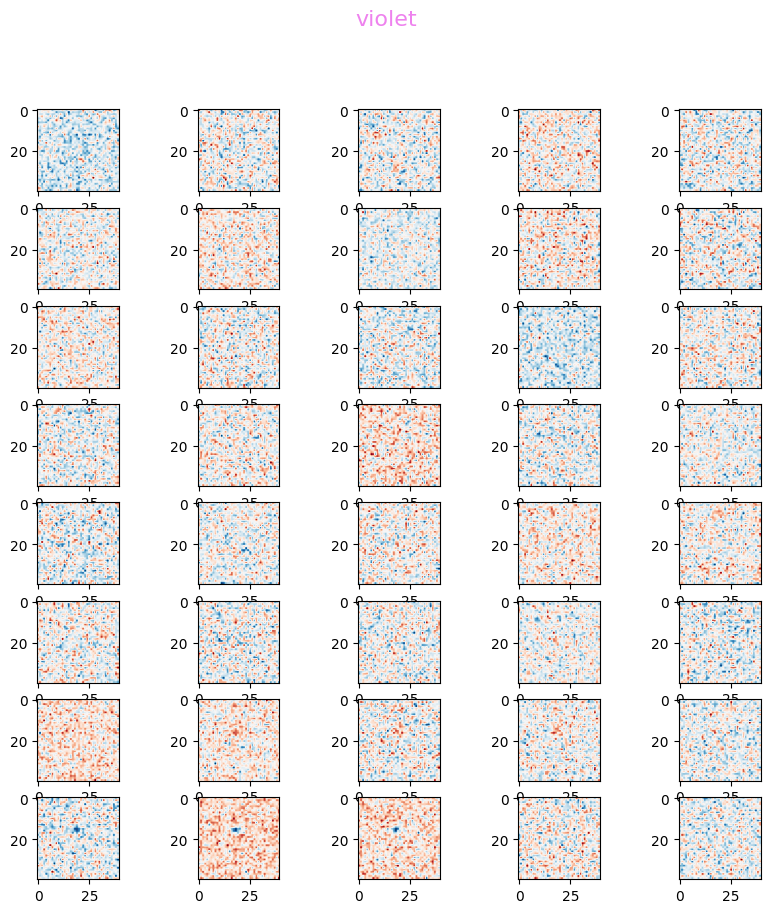

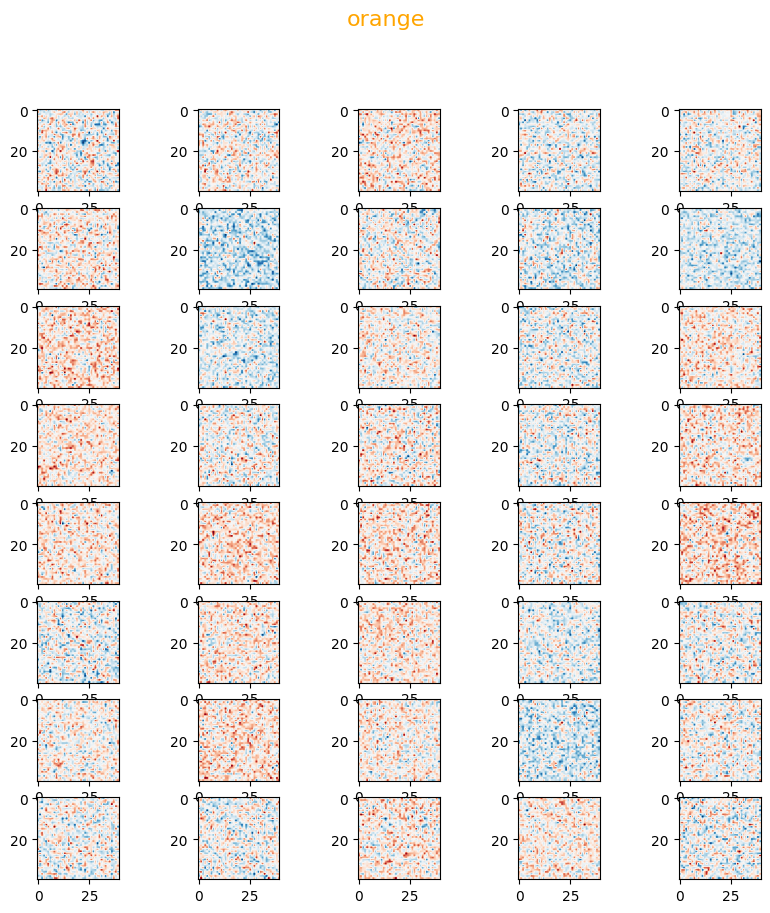

In [26]:
"""
    Input
"""

print('Total : {} neurons found \n\nClusters id :\n{}\n'.format(len(checkerboard_spikes.keys()),cells_id))
cell_id = int(input("Wich cell to select : "))

sta_data_file = os.path.normpath(os.path.join(check_directory, 'sta_data_3D.pkl'))
sta_data = load_obj(sta_data_file)

"""
    Plotting
"""

fig = plt.figure(figsize=(10,10))
fig.suptitle(color1, color=color1, fontsize=16)
gs = GridSpec(8, 5, figure=fig)
for i in range(40):
    ax = fig.add_subplot(gs[i//5,i%5])
    ax.imshow(sta_data[cell_id]['c1']['sta_3D'][i],cmap='RdBu_r')
plt.show(block=False)
plt.close(fig)

fig = plt.figure(figsize=(10,10))
fig.suptitle(color2, color=color2, fontsize=16)
gs = GridSpec(8, 5, figure=fig)
for i in range(40):
    ax = fig.add_subplot(gs[i//5,i%5])
    ax.imshow(sta_data[cell_id]['c2']['sta_3D'][i],cmap='RdBu_r')
plt.show(block=False)
plt.close(fig)


### Cell 6 : Fitting ellipses

#### <center><i>REQUIRES CELL 1 RUN AND CELL 4 OUTPUT </center>

In [13]:
"""
    Processing
"""

# File loading the 3D sta dictionnary saved above in this notebook
sta_data_file = os.path.normpath(os.path.join(check_directory, 'sta_data_3D.pkl'))
sta_data = load_obj(sta_data_file)

for cell_id in tqdm(sta_data):
    sta_3D_c1 = sta_data[cell_id]['c1']['sta_3D']
    
    if np.max(np.abs(sta_3D_c1)) == 0:
        print(f'No ellipse fit on cell {cell_id} with {color1}')
        sta_data[cell_id]['c1']["center_analyse"]   = {'Spatial':np.zeros(checkerboard[0].shape), 'Temporal':np.zeros(checkerboard.shape[0]), 'EllipseCoor':np.asarray([0, 0, 0, 0.001, 0.001, 0]), 'Cell_delay':np.nan}
        sta_data[cell_id]['c1']["surround_analyse"] = {'Spatial':np.zeros(checkerboard[0].shape), 'Temporal':np.zeros(checkerboard.shape[0]), 'EllipseCoor':np.asarray([0, 0, 0, 0.001, 0.001, 0]), 'Cell_delay':np.nan}
        sta_data[cell_id]['c1']["analyse_sta"]      = {'Spatial':np.zeros(checkerboard[0].shape), 'Temporal':np.zeros(checkerboard.shape[0]), 'EllipseCoor':np.asarray([0, 0, 0, 0.001, 0.001, 0]), 'Cell_delay':np.nan}

        continue
    
    sta_data[cell_id]['c1']["center_analyse"]   = analyse_sta_tom(sta_3D_c1, cell_id)
    
for cell_id in tqdm(sta_data):
    sta_3D_c2 = sta_data[cell_id]['c2']['sta_3D']
    
    if np.max(np.abs(sta_3D_c2)) == 0:
        print(f'No ellipse fit on cell {cell_id}  with {color2}')
        sta_data[cell_id]['c2']["center_analyse"]   = {'Spatial':np.zeros(checkerboard[0].shape), 'Temporal':np.zeros(checkerboard.shape[0]), 'EllipseCoor':np.asarray([0, 0, 0, 0.001, 0.001, 0]), 'Cell_delay':np.nan}
        sta_data[cell_id]['c2']["surround_analyse"] = {'Spatial':np.zeros(checkerboard[0].shape), 'Temporal':np.zeros(checkerboard.shape[0]), 'EllipseCoor':np.asarray([0, 0, 0, 0.001, 0.001, 0]), 'Cell_delay':np.nan}
        sta_data[cell_id]['c2']["analyse_sta"]      = {'Spatial':np.zeros(checkerboard[0].shape), 'Temporal':np.zeros(checkerboard.shape[0]), 'EllipseCoor':np.asarray([0, 0, 0, 0.001, 0.001, 0]), 'Cell_delay':np.nan}
        
        continue
    
    sta_data[cell_id]['c2']["center_analyse"]   = analyse_sta_tom(sta_3D_c2, cell_id)
    
"""
    Saving
"""

#File where all fitted data are saved
fitted_file = os.path.normpath(os.path.join(check_directory,'sta_data_3D_fitted.pkl'))
save_obj(sta_data, fitted_file)
    
print('--Fitting Done--')

  0%|          | 0/108 [00:00<?, ?it/s]

  0%|          | 0/108 [00:00<?, ?it/s]

--Fitting Done--


# Plotting STAs and their fitted ellipses

  0%|          | 0/108 [00:00<?, ?it/s]

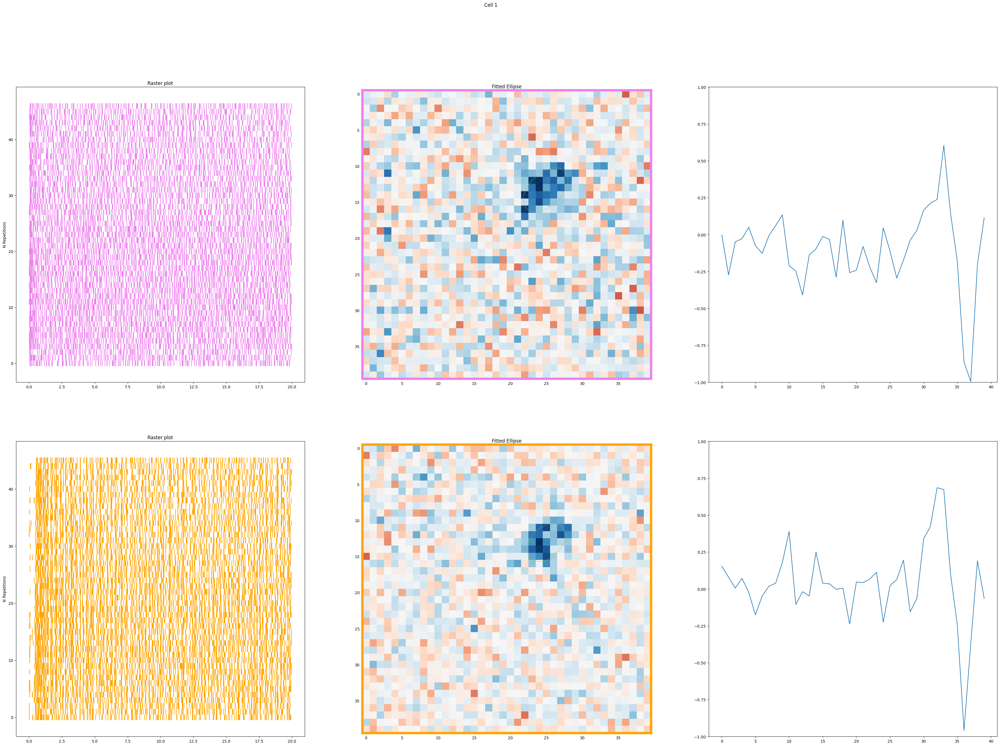

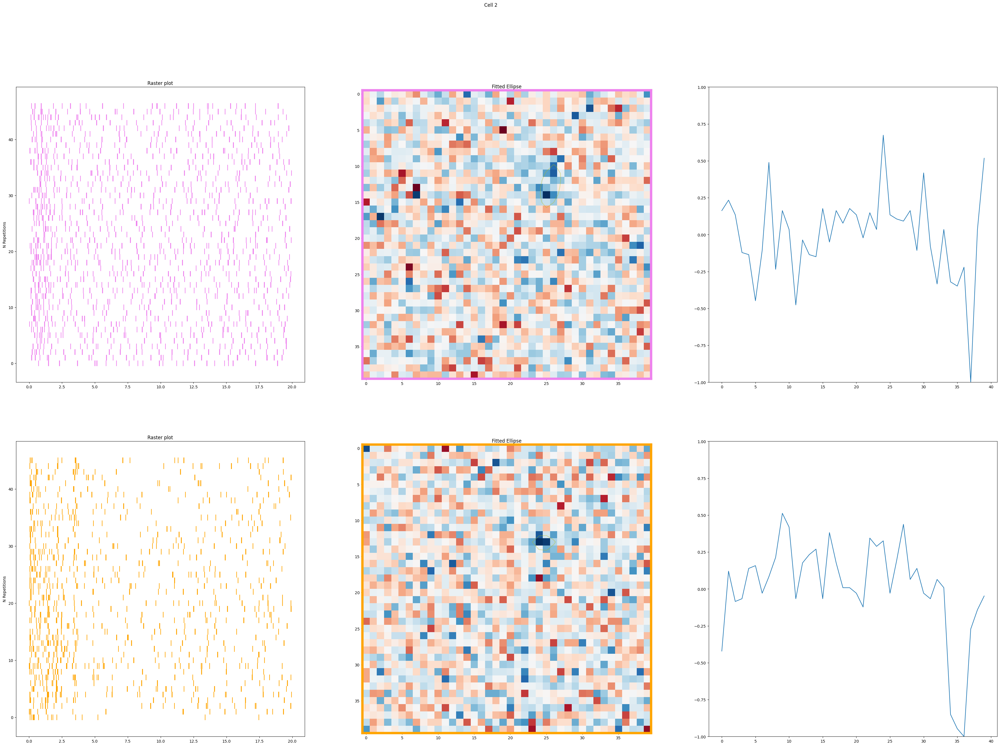

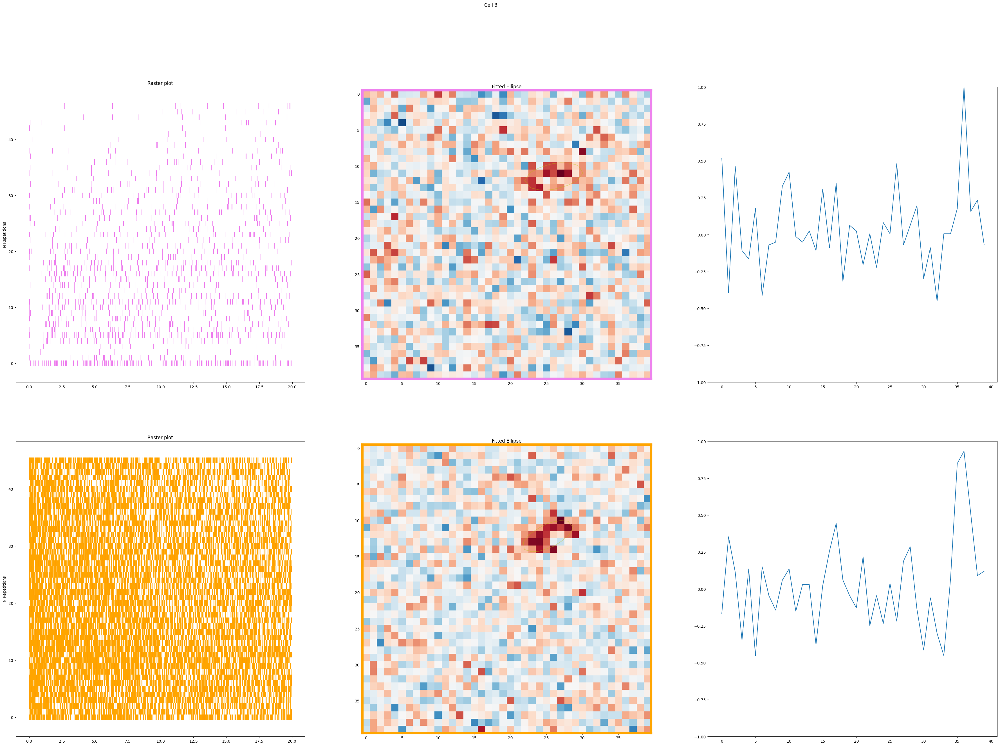

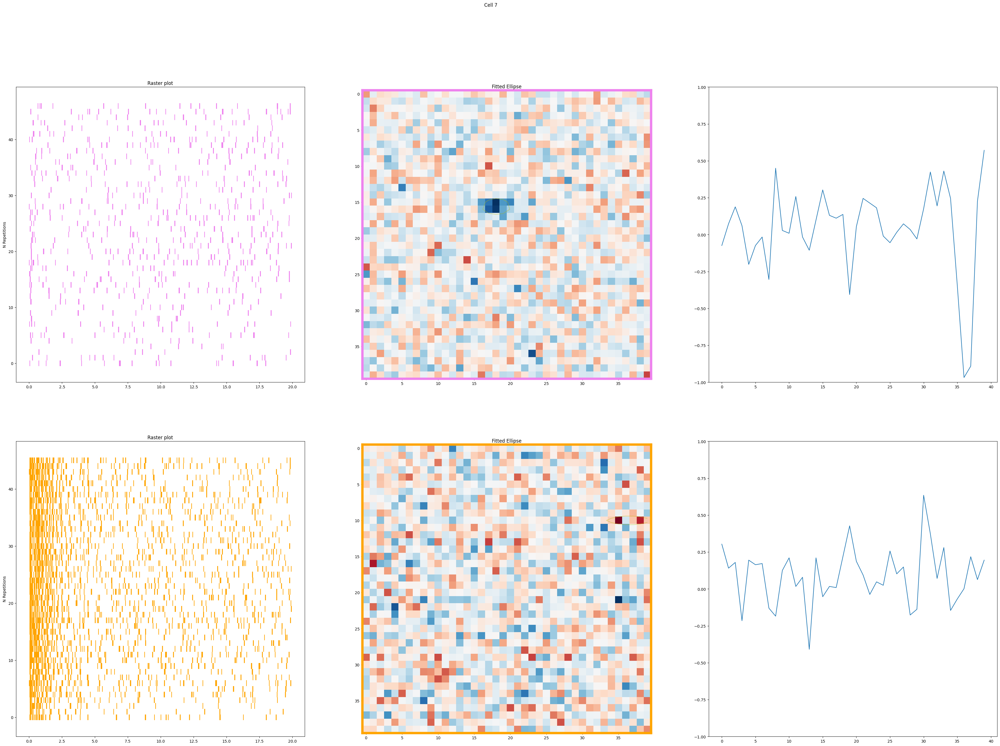

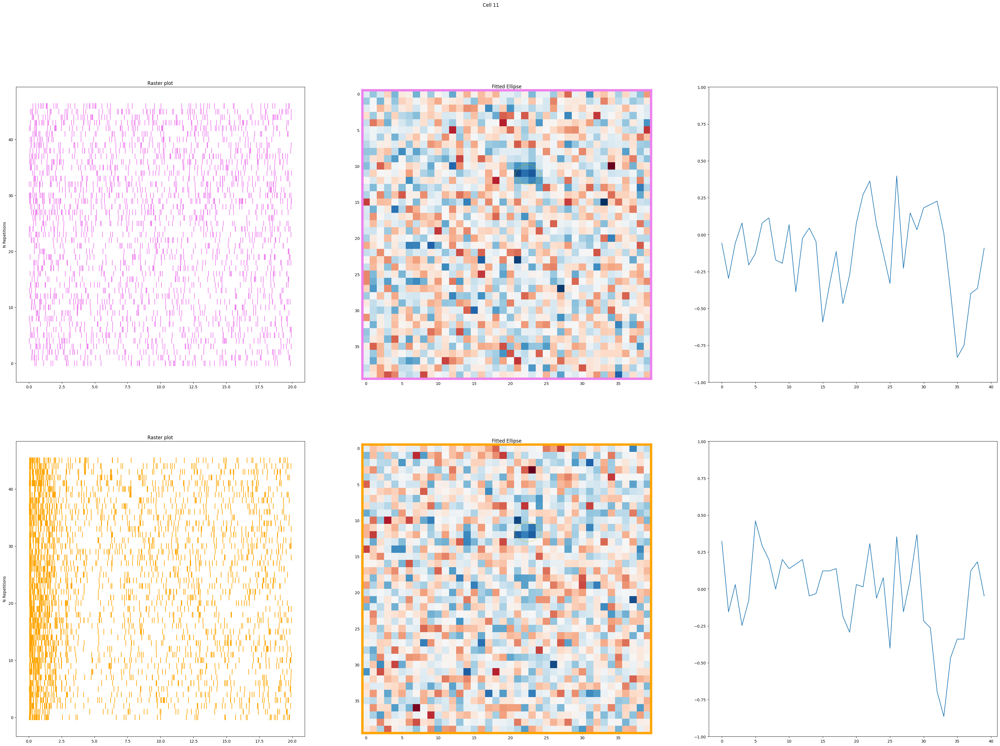

...

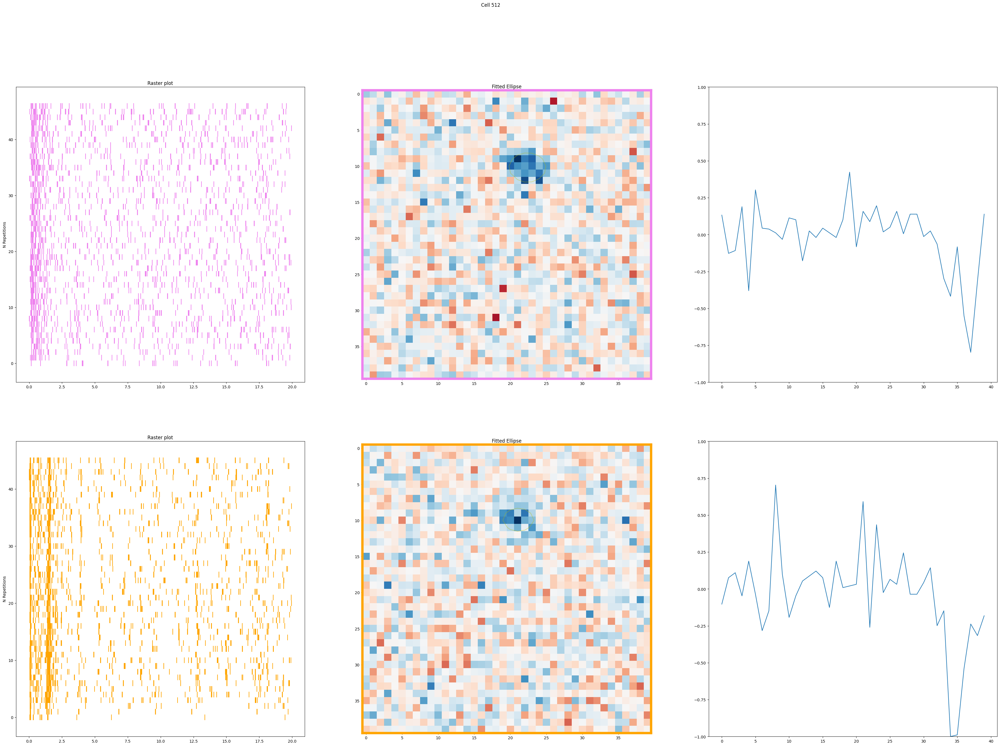

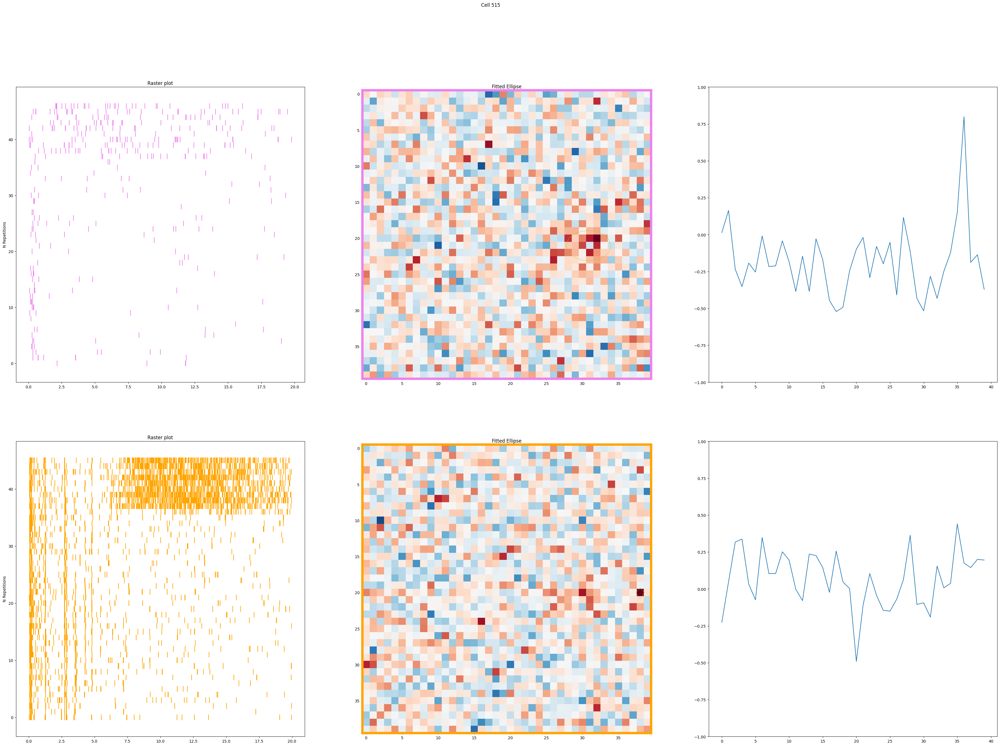

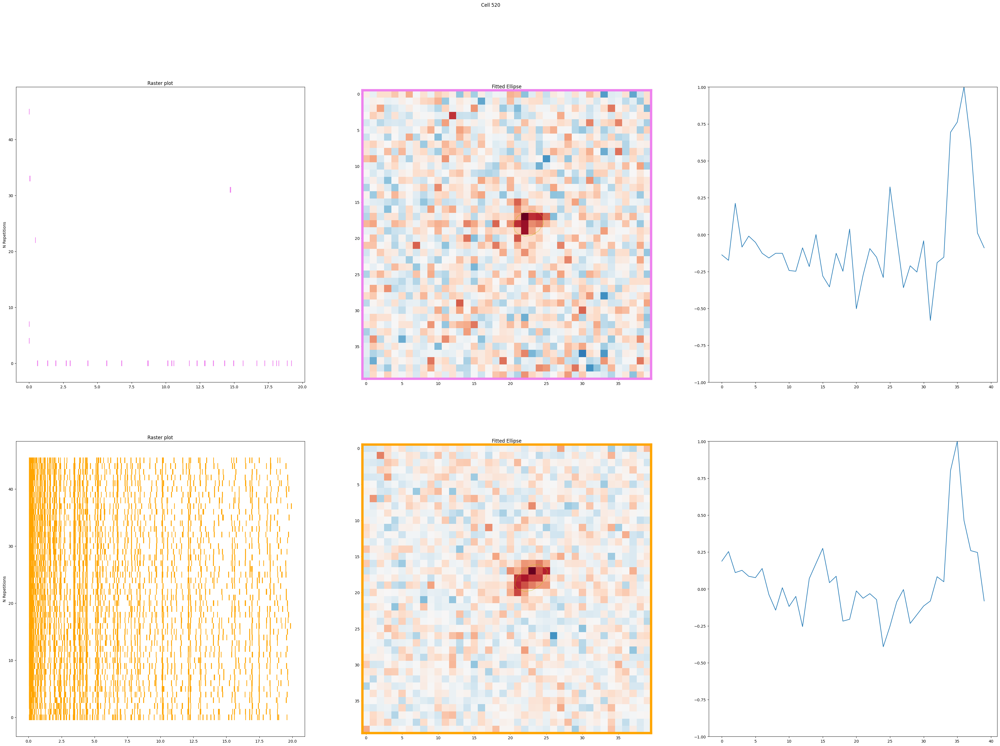

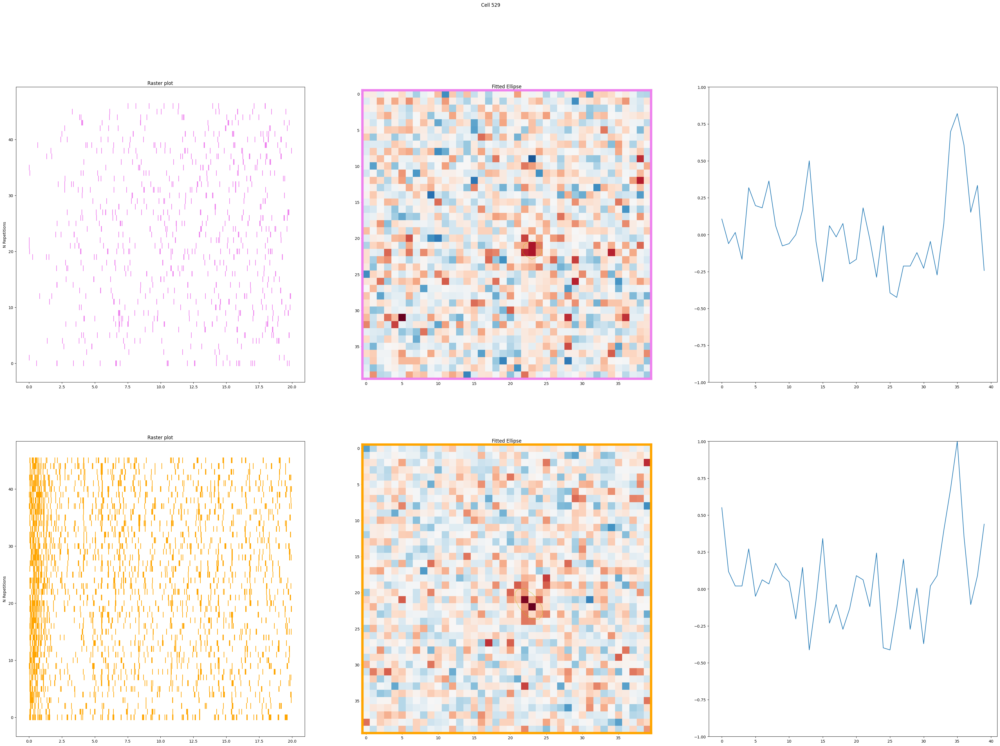

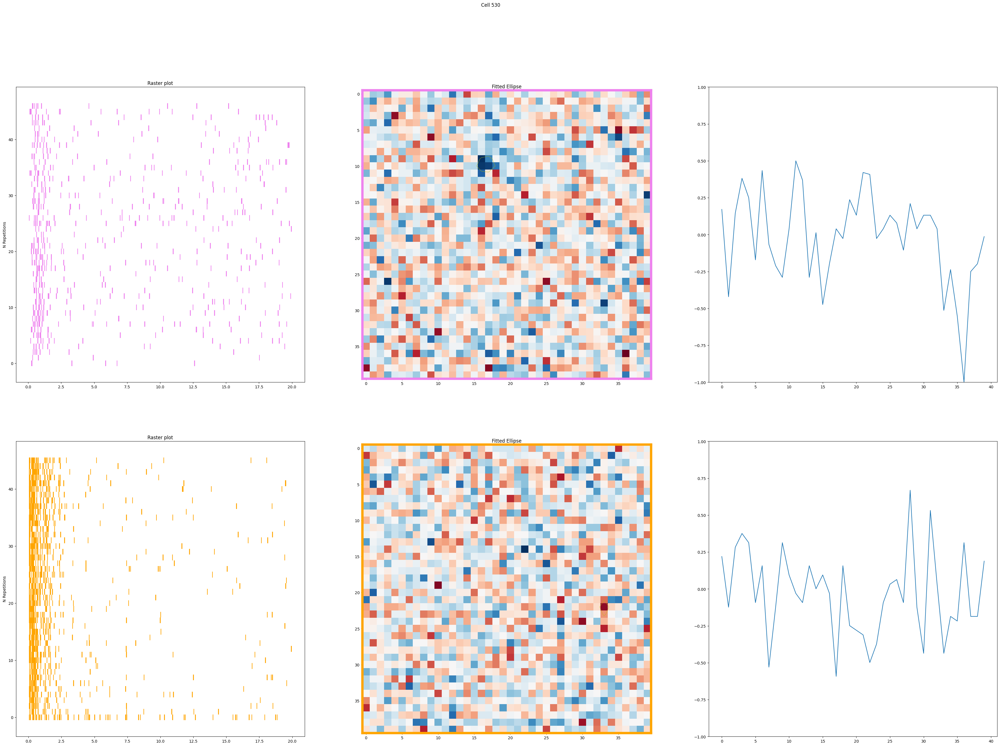

In [14]:
"""
    Plotting
"""

#Folder where figure will be saved
fig_directory = os.path.normpath(os.path.join(check_directory,r'Stas_figs'))
if not os.path.isdir(fig_directory): os.makedirs(fig_directory)

sta_data=np.load(os.path.join(check_directory,'sta_data_3D_fitted.pkl'),allow_pickle=True)

for cell_id in tqdm(cells_id[0:]):
    fig, axs = plt.subplots(nrows = 2,ncols = 3, figsize=(45,30))

    plt.suptitle(f'Cell {cell_id}')
    sta_c1=sta_data[cell_id]['c1']["center_analyse"]
    ax = axs[0,0]
    ax.eventplot(raster_data[cell_id][0]["spike_trains"],color=color1)
    ax.set(title = "Raster plot", ylabel='N Repetitions')

    ax = axs[0,1]
    ax.set(title = "Fitted Ellipse")
    ax.spines['top'].set(lw=6, color=color1)
    ax.spines['bottom'].set(lw=6, color=color1)
    ax.spines['left'].set(lw=6, color=color1)
    ax.spines['right'].set(lw=6, color=color1)
    
    try:
        ax = plot_sta_tom(ax, sta_c1['Spatial'],sta_c1['EllipseCoor'])
    except: 
        ax.imshow(sta_data[cell_id]['c1']["center_analyse"]['Spatial'])

    ax=axs[0,2]
    ax.plot(sta_c1['Temporal'])
    ax.set_ylim([-1,1])

    sta_c2=sta_data[cell_id]['c2']["center_analyse"]
    ax = axs[1,0]
    ax.eventplot(raster_data[cell_id][1]["spike_trains"],color=color2)
    ax.set(title = "Raster plot", ylabel='N Repetitions')

    ax = axs[1,1]
    ax.set(title = "Fitted Ellipse")
    ax.spines['top'].set(lw=6, color=color2)
    ax.spines['bottom'].set(lw=6, color=color2)
    ax.spines['left'].set(lw=6, color=color2)
    ax.spines['right'].set(lw=6, color=color2)

    try:
        ax = plot_sta_tom(ax, sta_c2['Spatial'],sta_c2['EllipseCoor'])
    except: 
        ax.imshow(sta_data[cell_id]['c2']["center_analyse"]['Spatial'])
    
    ax=axs[1,2]
    ax.plot(sta_c2['Temporal'])
    ax.set_ylim([-1,1])
    
    fig_file = os.path.join(fig_directory,f'Cell_{cell_id}.png')
    plt.savefig(fig_file, dpi=fig.dpi)
    plt.show()
    plt.clf()
    plt.close()

# --------- end of the notebook---------------------------------------